In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
df = pd.read_csv('/content/drive/Shareddrives/Grupo Rappitendeiros/all.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:3326: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
%%capture
!pip install -U pandas_profiling

In [ ]:
df.head()

,Unnamed: 0,ID,CHURN,LEVEL_NAME,MODAL,HAVE_CARD,COUNT_TO_GMV,GMV,PUNISHMENT_TYPE_permanent_block,PUNISHMENT_TYPE_temporary_block,...,DISTANCE_TO_USER,ORDERS_DONE,ORDERS_CANCEL,CANCELS_OPS_RT,EARNINGS,TIPS,EARNINGS_PER_ORDER,ORDER_DONE_RATE,EARNINGS_PER_DISTANCE,AUTO_ACEITE
0,0,32818,True,0,0,0,0,0.000000,0.0,0.0,...,5.688549,3,0,0,17.2300,15.000000,10.743333,1.000000,5.665768,1
1,1,33051,True,2,bicycle,0,1,4.260674,0.0,0.0,...,1311.727200,2311,49,2,1021.8467,351.166667,0.594121,0.979237,1.046722,1
2,2,33051,True,2,bicycle,0,1,4.260674,0.0,1.0,...,1311.727200,2311,49,2,1021.8467,351.166667,0.594121,0.979237,1.046722,1
3,68,33051,True,2,bicycle,0,1,4.260674,1.0,0.0,...,1311.727200,2311,49,2,1021.8467,351.166667,0.594121,0.979237,1.046722,1
4,80,33052,False,0,0,0,0,0.000000,0.0,0.0,...,8.233477,0,2,1,0.0000,0.000000,0.000000,0.000000,0.000000,1


In [ ]:
df = df.replace({'CHURN':{True:1, False:0}}) 

In [ ]:
import pandas_profiling
from pandas_profiling import ProfileReport

profile = ProfileReport (df)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Execução

In [ ]:
df_all = pd.read_csv('/content/drive/Shareddrives/Grupo Rappitendeiros/all.csv', usecols=(['ID', 'CHURN' ,'EARNINGS_PER_DISTANCE', 'DISTANCE_TO_USER', 'ORDERS_CANCEL']))

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:3326: DtypeWarning:

Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.



In [ ]:
df_all['CHURN'].value_counts()

True     118466
True      58705
False     44343
False     26030
0          1031
Name: CHURN, dtype: int64

In [ ]:
df_all = df_all.replace({'CHURN':{True:1, False:0, 'True':1, 'False':0, '0':0}}) 

In [ ]:
df_all['CHURN'].value_counts()

1    177171
0     71404
Name: CHURN, dtype: int64

In [ ]:
df_all.CHURN.unique()

array([1, 0])

In [ ]:
df_all.isna().sum()

ID                       0
CHURN                    0
DISTANCE_TO_USER         0
ORDERS_CANCEL            0
EARNINGS_PER_DISTANCE    0
dtype: int64

In [ ]:
df_all = df_all.dropna()

In [ ]:
df_all['EARNINGS_PER_DISTANCE'].value_counts

<bound method IndexOpsMixin.value_counts of 0         5.665768
1         1.046722
2         1.046722
3         1.046722
4         0.000000
            ...   
248570    0.000000
248571    3.088088
248572    1.656134
248573    0.997410
248574    2.541543
Name: EARNINGS_PER_DISTANCE, Length: 248575, dtype: float64>

In [ ]:
import plotly.express as px

fig = px.line(df_all, x='EARNINGS_PER_DISTANCE', y="ID")
fig.show()

Podemos concluir que temos entregadores que possuem uma receita desproporcional a média dos RT's, havendo necessidade de limpar os dados:


In [ ]:
#Colocamos como referência valores acima de R$10.000 como um limite de receita, ou seja, pessoas que recebam acima disso 
#serão considerados outliers e serão removidos:

df_clean_1 = df_all.query('EARNINGS_PER_DISTANCE < 10000')
df_clean_1

,ID,CHURN,DISTANCE_TO_USER,ORDERS_CANCEL,EARNINGS_PER_DISTANCE
0,32818,1,5.688549,0,5.665768
1,33051,1,1311.727200,49,1.046722
2,33051,1,1311.727200,49,1.046722
3,33051,1,1311.727200,49,1.046722
4,33052,0,8.233477,2,0.000000
...,...,...,...,...,...
248570,1552564,0,4.044593,2,0.000000
248571,1552588,0,180.270100,0,3.088088
248572,1552604,0,122.308910,0,1.656134
248573,1552649,0,831.663700,1,0.997410


In [ ]:
df_clean_1.describe()

,ID,CHURN,DISTANCE_TO_USER,ORDERS_CANCEL,EARNINGS_PER_DISTANCE
count,2.485480e+05,248548.000000,248548.000000,248548.000000,248548.000000
mean,1.008359e+06,0.712719,858.919340,13.854241,2.266676
std,4.505855e+05,0.452494,1692.925894,23.094544,28.706630
min,3.281800e+04,0.000000,0.000000,0.000000,0.000000
25%,6.723265e+05,0.000000,16.566544,1.000000,0.546696
50%,1.149640e+06,1.000000,131.801750,4.000000,1.077473
75%,1.386921e+06,1.000000,890.801640,17.000000,2.128530
max,1.552668e+06,1.000000,23555.842000,382.000000,6478.913711


In [ ]:
graph_dist = px.line(df_clean_1, x='DISTANCE_TO_USER', y="ID")
graph_dist.show()

In [ ]:
df_clean_2 = df_clean_1.query('DISTANCE_TO_USER < 15.000')
df_clean_2

,ID,CHURN,DISTANCE_TO_USER,ORDERS_CANCEL,EARNINGS_PER_DISTANCE
0,32818,1,5.688549,0,5.665768
4,33052,0,8.233477,2,0.000000
19,33249,0,6.697244,50,0.000000
26,33293,1,5.235063,22,1.098363
43,33347,1,6.478926,0,1.338185
...,...,...,...,...,...
248559,1552327,0,13.074185,0,4.222825
248562,1552360,0,1.001523,1,0.000000
248567,1552478,0,8.254116,1,3.403151
248568,1552491,0,3.782773,1,5.562057


In [ ]:
df_clean_2.CHURN.unique()

array([1, 0])

In [ ]:
df_clean_2.describe()

,ID,CHURN,DISTANCE_TO_USER,ORDERS_CANCEL,EARNINGS_PER_DISTANCE
count,5.918900e+04,59189.000000,59189.000000,59189.000000,59189.000000
mean,1.038699e+06,0.754312,6.084388,2.113974,5.208548
std,4.525760e+05,0.430498,3.948547,7.728720,58.656720
min,3.281800e+04,0.000000,0.000000,0.000000,0.000000
25%,7.014760e+05,1.000000,2.792380,0.000000,0.948813
50%,1.239818e+06,1.000000,5.275531,0.000000,2.156904
75%,1.406879e+06,1.000000,9.011230,1.000000,3.834686
max,1.552564e+06,1.000000,14.999912,267.000000,6478.913711


In [ ]:
graph_cancel = px.line(df_clean_2, x='ORDERS_CANCEL', y="ID")
graph_cancel.show()

In [ ]:
df_clean_3 = df_clean_2.query('ORDERS_CANCEL > 200')
df_clean_3

,ID,CHURN,DISTANCE_TO_USER,ORDERS_CANCEL,EARNINGS_PER_DISTANCE
1644,47209,1,4.223968,227,4.607043
19721,204447,0,4.569838,267,1.461759


A partir dessa análise, vemos que só existem 2 valores maiores do que 200, então foi decidido manter essas referências por não serem valores fora do possível

In [ ]:
df_final = df_clean_2  

In [ ]:
df_final

,ID,CHURN,DISTANCE_TO_USER,ORDERS_CANCEL,EARNINGS_PER_DISTANCE
0,32818,1,5.688549,0,5.665768
4,33052,0,8.233477,2,0.000000
19,33249,0,6.697244,50,0.000000
26,33293,1,5.235063,22,1.098363
43,33347,1,6.478926,0,1.338185
...,...,...,...,...,...
248559,1552327,0,13.074185,0,4.222825
248562,1552360,0,1.001523,1,0.000000
248567,1552478,0,8.254116,1,3.403151
248568,1552491,0,3.782773,1,5.562057


In [ ]:
df_final['CHURN'].value_counts()

1    44647
0    14542
Name: CHURN, dtype: int64

# Separação de dados de teste e treino e rebalanceamento

In [ ]:
# definição de x e y para treinamento e testagem dos modelos
x = df_final[['EARNINGS_PER_DISTANCE', 'DISTANCE_TO_USER', 'ORDERS_CANCEL']]
y = df_final['CHURN']

# rebalanceamento oversampling dos dados x y de treino
from imblearn.over_sampling import RandomOverSampler
rus = RandomOverSampler(random_state=0)
x_resampled, y_resampled = rus.fit_resample(x, y)

print(y_resampled.value_counts())

1    44647
0    44647
Name: CHURN, dtype: int64


In [ ]:
# separação dos dados entre teste e treino
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x_resampled, y_resampled, test_size=0.3, random_state=3) #split = separação entre teste e treino

# checagem se precisamos realizar rebalanceamento dos dados
print(y_train.value_counts())

1    31275
0    31230
Name: CHURN, dtype: int64


In [ ]:
# Colocando todas as métricas em uma variável para facilitar a implementação
def metricas(modelo):
  from sklearn.metrics import recall_score, precision_score, f1_score
  print('Acuracidade (treino): ', modelo.score(x_train, y_train))
  print('Acuracidade (teste): ', modelo.score(x_test, y_test))
  print('Revocação: ', recall_score(y_test, y_pred))
  print('Precisão: ', precision_score(y_test, y_pred))
  print('F1_score: ', f1_score(y_test, y_pred))

In [ ]:
# bibliotecas para matriz de confusão 
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Modelos

In [ ]:
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

## K Nearnest Neighbour - KNN


### Padrão


In [ ]:
# modelo de classificação K-Nearest Neighbours
from sklearn.neighbors import KNeighborsClassifier

## instanciação do objeto e treinamento do modelo KNN
knn = KNeighborsClassifier(n_neighbors=3).fit(x_train, y_train.squeeze())
# predição do modelo 
y_pred = knn.predict(x_test)
metricas(knn)

Acuracidade (treino):  0.9578113750899928
Acuracidade (teste):  0.9074246892381201
Revocação:  0.884833981453784
Precisão:  0.9264015032884435
F1_score:  0.9051407588739289


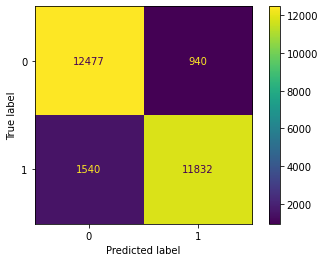

In [ ]:
# definição das variáveis utilizadas na matriz de confusão 
y_true = y_test
cm = confusion_matrix(y_true, y_pred)
# matriz
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=knn.classes_)
disp.plot()
plt.show()

### Testagem de hiperparâmetros

In [ ]:
# definir o espaço possível dos hiperparametros a serem testados no modelo
parametros = {'n_neighbors': [3, 5, 7, 9, 13, 17, 21, 29],
              'weights': ['uniform', 'distance'],
              'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
              'leaf_size': [15, 30, 45, 60]}

# achando os hiperparâmetros e treinando o modelo 
knn_grid_search = GridSearchCV(estimator = KNeighborsClassifier(), param_grid=parametros)
knn_grid_search.fit(x_train, y_train.squeeze())
print(knn_grid_search.best_score_)
print(knn_grid_search.best_params_)

0.9644828413726902
{'algorithm': 'auto', 'leaf_size': 15, 'n_neighbors': 29, 'weights': 'distance'}


Variando o parâmetro ```n_neighbours``` 

In [ ]:
## instanciação do objeto e treinamento do modelo KNN
knn = KNeighborsClassifier(n_neighbors=3, leaf_size=15, weights='distance').fit(x_train, y_train.squeeze())
# predição do modelo 
y_pred = knn.predict(x_test)
metricas(knn)

Acuracidade (treino):  0.9998880089592832
Acuracidade (teste):  0.9337787898017843
Revocação:  0.8925366437331738
Precisão:  0.972539113428944
F1_score:  0.9308220246451412


In [ ]:
## instanciação do objeto e treinamento do modelo KNN
knn = KNeighborsClassifier(n_neighbors=9, leaf_size=15, weights='distance').fit(x_train, y_train.squeeze())
# predição do modelo 
y_pred = knn.predict(x_test)
metricas(knn)

Acuracidade (treino):  0.9998880089592832
Acuracidade (teste):  0.9500541266937922
Revocação:  0.9262638348788513
Precisão:  0.9723661485319517
F1_score:  0.9487552661815396


In [ ]:
## instanciação do objeto e treinamento do modelo KNN
knn = KNeighborsClassifier(n_neighbors=17, leaf_size=15, weights='distance').fit(x_train, y_train.squeeze())
# predição do modelo 
y_pred = knn.predict(x_test)
metricas(knn)

Acuracidade (treino):  0.9998880089592832
Acuracidade (teste):  0.9610661092239352
Revocação:  0.9486239904277595
Precisão:  0.9727014799478567
F1_score:  0.9605118691553401


Variando o parâmetro ```weights``` 

# Novo tratamento de dados

In [ ]:
df_all = pd.read_csv('/content/drive/Shareddrives/Grupo Rappitendeiros/arthur.csv', usecols=(['CHURN','ID','DAILY_HOURS','DAILY_ORDERS','MONTHLY_EARNINGS','DAILY_DISTANCE','MONTHLY_TIPS','DISTANCE_PER_ORDER','DAILY_DISTANCE']))

In [ ]:
df_all['CHURN'].value_counts()

True     123248
False     37373
Name: CHURN, dtype: int64

In [ ]:
df_all = df_all.replace({'CHURN':{True:1, False:0, 'True':1, 'False':0, '0':0}}) 

In [ ]:
df_all['CHURN'].value_counts()

1    123248
0     37373
Name: CHURN, dtype: int64

In [ ]:
df_all.CHURN.unique()

array([1, 0])

In [ ]:
df_all.isna().sum()

ID                    0
CHURN                 0
DAILY_HOURS           0
DAILY_ORDERS          0
MONTHLY_EARNINGS      0
MONTHLY_TIPS          0
DISTANCE_PER_ORDER    0
DAILY_DISTANCE        0
dtype: int64

In [ ]:
df_all = df_all.dropna()

In [ ]:
df_all['MONTHLY_EARNINGS'].value_counts

<bound method IndexOpsMixin.value_counts of 0         1848.040000
1          672.120000
2           46.710000
3          876.111667
4          264.054000
             ...     
160616     202.807500
160617    4610.473846
160618     380.326667
160619    3277.736923
160620     794.564167
Name: MONTHLY_EARNINGS, Length: 160621, dtype: float64>

In [ ]:
import plotly.express as px

fig = px.line(df_all, x='MONTHLY_EARNINGS', y="ID")
fig.show()

Podemos concluir que temos entregadores que possuem uma receita desproporcional a média dos RT's, havendo necessidade de limpar os dados:


In [ ]:
#Colocamos como referência valores acima de R$10.000 como um limite de receita, ou seja, pessoas que recebam acima disso 
#serão considerados outliers e serão removidos:

df_clean_1 = df_all.query('MONTHLY_EARNINGS < 10000')
df_clean_1

,ID,CHURN,DAILY_HOURS,DAILY_ORDERS,MONTHLY_EARNINGS,MONTHLY_TIPS,DISTANCE_PER_ORDER,DAILY_DISTANCE
0,1286316,1,3.995590,7.640449,1848.040000,326.571429,3.446071,26.329531
1,1036587,1,7.989556,16.000000,672.120000,127.666667,3.386037,54.176596
2,106854,1,0.583576,0.750000,46.710000,23.666667,2.870784,2.153088
3,359949,1,5.628855,3.118577,876.111667,103.583333,3.455666,10.776761
4,64922,1,1.774453,1.121212,264.054000,82.600000,3.383588,3.793720
...,...,...,...,...,...,...,...,...
160616,33266,0,3.969117,1.622951,202.807500,61.500000,3.268752,5.305024
160617,33263,0,4.383588,5.483871,4610.473846,348.307692,3.101561,17.008559
160618,33203,0,5.870796,3.744966,380.326667,159.833333,2.136435,8.000878
160619,33194,0,3.337319,4.515789,3277.736923,275.307692,3.796884,17.145927


In [ ]:
df_clean_1.describe()

,ID,CHURN,DAILY_HOURS,DAILY_ORDERS,MONTHLY_EARNINGS,MONTHLY_TIPS,DISTANCE_PER_ORDER,DAILY_DISTANCE
count,1.606180e+05,160618.000000,160618.000000,160618.000000,160618.000000,160618.000000,160618.000000,160618.000000
mean,1.036491e+06,0.767324,3.600676,2.145477,276.183436,59.990429,2.847094,6.005815
std,4.599419e+05,0.422539,2.318134,2.431598,469.408385,103.433689,1.546166,7.638674
min,3.281800e+04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,6.944990e+05,1.000000,1.827042,0.400000,21.963375,4.000000,1.877219,1.030693
50%,1.213154e+06,1.000000,3.210037,1.250000,87.996667,18.000000,2.795648,3.279246
75%,1.419200e+06,1.000000,4.978980,3.111111,325.336000,70.166667,3.565576,8.143594
max,1.556765e+06,1.000000,18.222825,36.000000,8750.910000,3725.750000,215.088772,553.994292


In [ ]:
graph_dist = px.line(df_clean_1, x='DAILY_ORDERS', y="ID")
graph_dist.show()

In [ ]:
df_clean_2 = df_clean_1.query('DAILY_ORDERS < 35')
df_clean_2

,ID,CHURN,DAILY_HOURS,DAILY_ORDERS,MONTHLY_EARNINGS,MONTHLY_TIPS,DISTANCE_PER_ORDER,DAILY_DISTANCE
0,1286316,1,3.995590,7.640449,1848.040000,326.571429,3.446071,26.329531
1,1036587,1,7.989556,16.000000,672.120000,127.666667,3.386037,54.176596
2,106854,1,0.583576,0.750000,46.710000,23.666667,2.870784,2.153088
3,359949,1,5.628855,3.118577,876.111667,103.583333,3.455666,10.776761
4,64922,1,1.774453,1.121212,264.054000,82.600000,3.383588,3.793720
...,...,...,...,...,...,...,...,...
160616,33266,0,3.969117,1.622951,202.807500,61.500000,3.268752,5.305024
160617,33263,0,4.383588,5.483871,4610.473846,348.307692,3.101561,17.008559
160618,33203,0,5.870796,3.744966,380.326667,159.833333,2.136435,8.000878
160619,33194,0,3.337319,4.515789,3277.736923,275.307692,3.796884,17.145927


In [ ]:
df_clean_2.CHURN.unique()

array([1, 0])

In [ ]:
df_clean_2.describe()

,ID,CHURN,DAILY_HOURS,DAILY_ORDERS,MONTHLY_EARNINGS,MONTHLY_TIPS,DISTANCE_PER_ORDER,DAILY_DISTANCE
count,1.606170e+05,160617.000000,160617.000000,160617.000000,160617.000000,160617.000000,160617.000000,160617.000000
mean,1.036489e+06,0.767322,3.600668,2.145267,276.183670,59.990803,2.847111,6.005811
std,4.599424e+05,0.422540,2.318139,2.430138,469.409837,103.433903,1.546157,7.638697
min,3.281800e+04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,6.944920e+05,1.000000,1.827037,0.400000,21.962500,4.000000,1.877246,1.030675
50%,1.213153e+06,1.000000,3.210000,1.250000,87.993333,18.000000,2.795650,3.279104
75%,1.419200e+06,1.000000,4.978980,3.111111,325.338000,70.166667,3.565579,8.143611
max,1.556765e+06,1.000000,18.222825,31.238095,8750.910000,3725.750000,215.088772,553.994292


In [ ]:
graph_cancel = px.line(df_clean_2, x='DAILY_DISTANCE', y="ID")
graph_cancel.show()

In [ ]:
df_clean_3 = df_clean_2.query('DAILY_DISTANCE > 200')
df_clean_3

,ID,CHURN,DAILY_HOURS,DAILY_ORDERS,MONTHLY_EARNINGS,MONTHLY_TIPS,DISTANCE_PER_ORDER,DAILY_DISTANCE
10250,590615,1,4.205556,5.0,53.900000,5.333333,110.798858,553.994292
29238,407340,1,1.690972,1.0,20.380000,3.000000,215.088772,215.088772
84044,1374632,1,2.877222,3.6,38.923333,14.333333,127.442749,458.793896


A partir dessa análise, vemos que só existem 2 valores maiores do que 200, então foi decidido manter essas referências por não serem valores fora do possível

In [ ]:
graph_cancel = px.line(df_clean_2, x='DISTANCE_PER_ORDER', y="ID")
graph_cancel.show()

In [ ]:
df_final = df_clean_2  

In [ ]:
df_final

,ID,CHURN,DAILY_HOURS,DAILY_ORDERS,MONTHLY_EARNINGS,MONTHLY_TIPS,DISTANCE_PER_ORDER,DAILY_DISTANCE
0,1286316,1,3.995590,7.640449,1848.040000,326.571429,3.446071,26.329531
1,1036587,1,7.989556,16.000000,672.120000,127.666667,3.386037,54.176596
2,106854,1,0.583576,0.750000,46.710000,23.666667,2.870784,2.153088
3,359949,1,5.628855,3.118577,876.111667,103.583333,3.455666,10.776761
4,64922,1,1.774453,1.121212,264.054000,82.600000,3.383588,3.793720
...,...,...,...,...,...,...,...,...
160616,33266,0,3.969117,1.622951,202.807500,61.500000,3.268752,5.305024
160617,33263,0,4.383588,5.483871,4610.473846,348.307692,3.101561,17.008559
160618,33203,0,5.870796,3.744966,380.326667,159.833333,2.136435,8.000878
160619,33194,0,3.337319,4.515789,3277.736923,275.307692,3.796884,17.145927


In [ ]:
df_final['CHURN'].value_counts()

1    123245
0     37372
Name: CHURN, dtype: int64

# Nova separação de dados de teste e treino e rebalanceamento
Nova separação, testagem com outras features

In [ ]:
# definição de x e y para treinamento e testagem dos modelos
x = df_final[['DAILY_HOURS','DAILY_ORDERS','MONTHLY_EARNINGS','MONTHLY_TIPS','DISTANCE_PER_ORDER','DAILY_DISTANCE']]
y = df_final['CHURN']

# rebalanceamento oversampling dos dados x y de treino
from imblearn.over_sampling import RandomOverSampler
rus = RandomOverSampler(random_state=0)
x_resampled, y_resampled = rus.fit_resample(x, y)

print(y_resampled.value_counts())

1    123245
0    123245
Name: CHURN, dtype: int64


In [ ]:
# separação dos dados entre teste e treino
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x_resampled, y_resampled, test_size=0.3, random_state=3) #split = separação entre teste e treino

# checagem se precisamos realizar rebalanceamento dos dados
print(y_train.value_counts())

1    86371
0    86172
Name: CHURN, dtype: int64


In [ ]:
# Colocando todas as métricas em uma variável para facilitar a implementação
def metricas(modelo):
  from sklearn.metrics import recall_score, precision_score, f1_score
  print('Acuracidade (treino): ', modelo.score(x_train, y_train))
  print('Acuracidade (teste): ', modelo.score(x_test, y_test))
  print('Revocação: ', recall_score(y_test, y_pred))
  print('Precisão: ', precision_score(y_test, y_pred))
  print('F1_score: ', f1_score(y_test, y_pred))

In [ ]:
# bibliotecas para matriz de confusão 
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Modelos

## Extra Trees

### Padrão

In [ ]:
# modelo de classificação Extra Trees
from sklearn.ensemble import ExtraTreesClassifier

# instanciação do objeto e treinamento do modelo Extra Trees
et = ExtraTreesClassifier().fit(x_train, y_train)
# predição do modelo
y_pred = et.predict(x_test)
metricas(et)

Acuracidade (treino):  1.0
Acuracidade (teste):  0.9145469052158979
Revocação:  0.9003633996854152
Precisão:  0.9262100711396289
F1_score:  0.9131038655647081


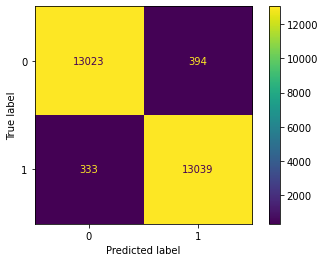

In [ ]:
# definição das variáveis utilizadas na matriz de confusão 
y_true = y_test
cm = confusion_matrix(y_true, y_pred)
# matriz
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=knn.classes_)
disp.plot()
plt.show()

### Testagem de hiperparâmetros

In [ ]:
from sklearn.model_selection import GridSearchCV

parameters={'criterion':['gini','entropy','log_loss'],
            'max_features':[int,float,'auto','sqrt','log2']}

modelET = GridSearchCV(estimator=ExtraTreesClassifier(), param_grid=parameters)

modelET.fit(x_train, y_train)
print(modelET.best_score_)
print(modelET.best_params_)

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning:


45 fits failed out of a total of 75.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py", line 467, in fit
    for i, t in enumerate(trees)
  File "/usr/local/lib/python3.7/dist-packages/joblib/parallel.py", line 1043, in __call__
    if self.dispatch_one_batch(iterator):
  File "/usr/local/lib/python3.7/dist-packages/joblib/par

0.8764887440826767
{'criterion': 'gini', 'max_features': 'auto'}


In [ ]:
# instanciação do objeto e treinamento do modelo Extra Trees
et = ExtraTreesClassifier(criterion='gini', max_features='auto').fit(x_train, y_train)
# predição do modelo
y_pred = et.predict(x_test)
metricas(et)

Acuracidade (treino):  1.0
Acuracidade (teste):  0.9138977916615955
Revocação:  0.8993328632640886
Precisão:  0.9258731887092722
F1_score:  0.9124100645196791


In [ ]:
et_best= modelET.best_estimator_
et_best

ExtraTreesClassifier()

Feature Importance:

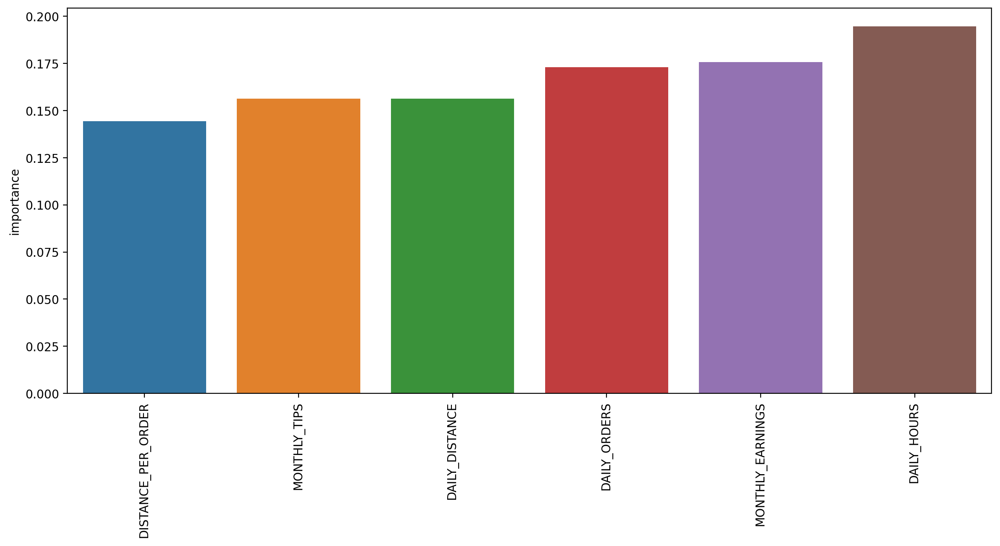

In [ ]:
#Importando bibliotecas necessárias para o gráfico de importância
from matplotlib import pyplot as plt
import seaborn as sns

et.feature_importances_
feats = pd.DataFrame(index=x.columns, data= et.feature_importances_, columns=['importance'])
imp_feats = feats[feats['importance'] > 0]
imp_feats = imp_feats.sort_values('importance')

plt.figure(figsize=(14,6),dpi=200)
sns.barplot(data=imp_feats.sort_values('importance'),x=imp_feats.sort_values('importance').index,y='importance')
plt.xticks(rotation=90);